In [1]:
import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob

In [2]:
from pickle import dump, load
from time import time

In [3]:
from keras.preprocessing import sequence

Using TensorFlow backend.


In [4]:
from keras.models import Sequential

In [5]:
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.optimizers import Adam, RMSprop
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras import Input, layers
from keras import optimizers
from keras.applications.inception_v3 import preprocess_input
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical

In [6]:
import tensorflow as tf
tf.__version__

'1.15.0'

In [7]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "C:\AI_EverythingAI\Image_Captioning\Flickr8k_text\Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:325])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the stairs to her playhouse .



In [8]:
def load_descriptions(doc):
	mapping = dict()
	# process lines
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		if len(line) < 2:
			continue
		# take the first token as the image id, the rest as the description
		image_id, image_desc = tokens[0], tokens[1:]
		# extract filename from image id
		image_id = image_id.split('.')[0]
		# convert description tokens back to string
		image_desc = ' '.join(image_desc)
		# create the list if needed
		if image_id not in mapping:
			mapping[image_id] = list()
		# store description
		mapping[image_id].append(image_desc)
	return mapping

# parse descriptions
descriptions = load_descriptions(doc)
print('Loaded: %d ' % len(descriptions))

Loaded: 8092 


In [9]:
list(descriptions.keys())[:5]

['1000268201_693b08cb0e',
 '1001773457_577c3a7d70',
 '1002674143_1b742ab4b8',
 '1003163366_44323f5815',
 '1007129816_e794419615']

In [10]:
descriptions['1000268201_693b08cb0e']

['A child in a pink dress is climbing up a set of stairs in an entry way .',
 'A girl going into a wooden building .',
 'A little girl climbing into a wooden playhouse .',
 'A little girl climbing the stairs to her playhouse .',
 'A little girl in a pink dress going into a wooden cabin .']

In [11]:
descriptions['1001773457_577c3a7d70']

['A black dog and a spotted dog are fighting',
 'A black dog and a tri-colored dog playing with each other on the road .',
 'A black dog and a white dog with brown spots are staring at each other in the street .',
 'Two dogs of different breeds looking at each other on the road .',
 'Two dogs on pavement moving toward each other .']

In [12]:
def clean_descriptions(descriptions):
	# prepare translation table for removing punctuation
	table = str.maketrans('', '', string.punctuation)
	for key, desc_list in descriptions.items():
		for i in range(len(desc_list)):
			desc = desc_list[i]
			# tokenize
			desc = desc.split()
			# convert to lower case
			desc = [word.lower() for word in desc]
			# remove punctuation from each token
			desc = [w.translate(table) for w in desc]
			# remove hanging 's' and 'a'
			desc = [word for word in desc if len(word)>1]
			# remove tokens with numbers in them
			desc = [word for word in desc if word.isalpha()]
			# store as string
			desc_list[i] =  ' '.join(desc)

# clean descriptions
clean_descriptions(descriptions)

In [13]:
descriptions['1000268201_693b08cb0e']

['child in pink dress is climbing up set of stairs in an entry way',
 'girl going into wooden building',
 'little girl climbing into wooden playhouse',
 'little girl climbing the stairs to her playhouse',
 'little girl in pink dress going into wooden cabin']

In [14]:
# convert the loaded descriptions into a vocabulary of words
def to_vocabulary(descriptions):
	# build a list of all description strings
	all_desc = set()
	for key in descriptions.keys():
		[all_desc.update(d.split()) for d in descriptions[key]]
	return all_desc

# summarize vocabulary
vocabulary = to_vocabulary(descriptions)
print('Original Vocabulary Size: %d' % len(vocabulary))

Original Vocabulary Size: 8763


In [15]:
# save descriptions to file, one per line
def save_descriptions(descriptions, filename):
	lines = list()
	for key, desc_list in descriptions.items():
		for desc in desc_list:
			lines.append(key + ' ' + desc)
	data = '\n'.join(lines)
	file = open(filename, 'w')
	file.write(data)
	file.close()

save_descriptions(descriptions, 'descriptions.txt')

In [16]:
# load a pre-defined list of photo identifiers
def load_set(filename):
	doc = load_doc(filename)
	dataset = list()
	# process line by line
	for line in doc.split('\n'):
		# skip empty lines
		if len(line) < 1:
			continue
		# get the image identifier
		identifier = line.split('.')[0]
		dataset.append(identifier)
	return set(dataset)

# load training dataset (6K)
filename = 'C:\AI_EverythingAI\Image_Captioning\Flickr8k_text\Flickr_8k.trainImages.txt'
train = load_set(filename)
print('Dataset: %d' % len(train))

Dataset: 6000


In [17]:
# Below path contains all the images
# images = 'C:/AI_EverythingAI/Image_Captioning/Flickr8k_Dataset/Flicker8k_Dataset'
# Create a list of all image names in the directory

import os
img = os.listdir("C:\AI_EverythingAI\Image_Captioning\Flickr8k_Dataset\Flicker8k_Dataset")

# img = glob.glob("C:\AI_EverythingAI\Image_Captioning\Flickr8k_Dataset\Flicker8k_Dataset\*.jpg")

In [18]:
len(img)

8091

In [19]:
# Below file contains the names of images to be used in train data
train_images_file = 'C:\AI_EverythingAI\Image_Captioning\Flickr8k_text\Flickr_8k.trainImages.txt'
# Read the train image names in a set
train_images = set(open(train_images_file, 'r').read().strip().split('\n'))

# Create a list of all the training images with their full path names
train_img = []

for i in img: # img is list of full path names of all images
    if i in train_images: # Check if the image belongs to training set
        train_img.append(i) # Add it to the list of train images

In [20]:
len(train_img)

6000

In [21]:
# Below file contains the names of images to be used in test data
test_images_file = 'C:\AI_EverythingAI\Image_Captioning\Flickr8k_text\Flickr_8k.testImages.txt'
# Read the validation image names in a set# Read the test image names in a set
test_images = set(open(test_images_file, 'r').read().strip().split('\n'))

# Create a list of all the test images with their full path names
test_img = []

for i in img: # img is list of full path names of all images
    if i in test_images: # Check if the image belongs to test set
        test_img.append(i) # Add it to the list of test images

In [22]:
len(img)

8091

In [23]:
# load clean descriptions into memory
def load_clean_descriptions(filename, dataset):
	# load document
	doc = load_doc(filename)
	descriptions = dict()
	for line in doc.split('\n'):
		# split line by white space
		tokens = line.split()
		# split id from description
		image_id, image_desc = tokens[0], tokens[1:]
		# skip images not in the set
		if image_id in dataset:
			# create list
			if image_id not in descriptions:
				descriptions[image_id] = list()
			# wrap description in tokens
			desc = 'startseq ' + ' '.join(image_desc) + ' endseq'
			# store
			descriptions[image_id].append(desc)
	return descriptions

# descriptions
train_descriptions = load_clean_descriptions('descriptions.txt', train)
print('Descriptions: train=%d' % len(train_descriptions))

Descriptions: train=6000


In [24]:
def preprocess(image_path):
    # Convert all the images to size 299x299 as expected by the inception v3 model
    im = "C:\AI_EverythingAI\Image_Captioning\Flickr8k_Dataset\Flicker8k_Dataset"
    ima = image.load_img(im + "\\" + image_path, target_size=(299, 299))
    # Convert PIL image to numpy array of 3-dimensions
    x = image.img_to_array(ima)
    # Add one more dimension
    x = np.expand_dims(x, axis=0)
    # preprocess the images using preprocess_input() from inception module
    x = preprocess_input(x)
    return x

In [25]:
# Load the inception v3 model
model = InceptionV3(weights='imagenet')

W0403 13:57:42.786897  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0403 13:57:42.797767  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0403 13:57:42.803875  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0403 13:57:42.830679  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0403 13:57:42.831678  7124 module_wrapper.py:139] From C:\Users\ritua\A

In [26]:
# Create a new model, by removing the last layer (output layer) from the inception v3
model_new = Model(model.input, model.layers[-2].output)

In [27]:

# Function to encode a given image into a vector of size (2048, )
def encode(image):
    image_1 = preprocess(image) # preprocess the image
    fea_vec = model_new.predict(image_1) # Get the encoding vector for the image
    fea_vec = np.reshape(fea_vec, fea_vec.shape[1]) # reshape from (1, 2048) to (2048, )
    return fea_vec

In [64]:
images = 'C:/AI_EverythingAI/Image_Captioning/Flickr8k_Dataset/Flicker8k_Dataset'

In [29]:
# Call the funtion to encode all the train images
# This will take a while on CPU - Execute this only once
start = time()
encoding_train = {}
for img_ in train_img:
    encoding_train[img_] = encode(img_)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 2063.998215675354


In [30]:
len(images)

70

In [31]:
encoding_train

{'1000268201_693b08cb0e.jpg': array([0.122776  , 0.33294892, 0.7527166 , ..., 0.21939652, 0.30216324,
        0.40283287], dtype=float32),
 '1001773457_577c3a7d70.jpg': array([0.7366834 , 0.59113246, 0.18194176, ..., 0.1603028 , 0.34144726,
        0.9083163 ], dtype=float32),
 '1002674143_1b742ab4b8.jpg': array([0.3735199 , 0.24596578, 0.9635311 , ..., 1.1459359 , 0.2654017 ,
        0.01983131], dtype=float32),
 '1003163366_44323f5815.jpg': array([0.48603112, 0.29218376, 0.31436756, ..., 0.98254746, 0.28108028,
        0.22330098], dtype=float32),
 '1007129816_e794419615.jpg': array([0.21595334, 0.15581973, 0.29477108, ..., 0.40565038, 0.16532041,
        0.37416974], dtype=float32),
 '1007320043_627395c3d8.jpg': array([0.17231011, 0.4980832 , 0.21577029, ..., 0.09676226, 1.229849  ,
        0.5421419 ], dtype=float32),
 '1009434119_febe49276a.jpg': array([0.5346088 , 1.3676212 , 0.78043485, ..., 0.39463878, 0.88772404,
        1.0728823 ], dtype=float32),
 '1012212859_01547e3f17.jpg

In [32]:
# Save the bottleneck train features to disk
with open("encoded_train_images.pkl", "wb") as encoded_pickle:
    dump(encoding_train, encoded_pickle)

In [33]:
# Call the funtion to encode all the test images - Execute this only once
start = time()
encoding_test = {}
for im_ in test_img:
    encoding_test[im_] = encode(im_)
print("Time taken in seconds =", time()-start)

Time taken in seconds = 341.3245108127594


In [42]:
img

'997722733_0cb5439472.jpg'

In [34]:
# Save the bottleneck test features to disk
with open("encoded_test_images.pkl", "wb") as encoded_pickle:
    dump(encoding_test, encoded_pickle)

In [35]:
train_features = load(open("encoded_train_images.pkl", "rb"))
print('Photos: train=%d' % len(train_features))

Photos: train=6000


In [36]:
# Create a list of all the training captions
all_train_captions = []
for key, val in train_descriptions.items():
    for cap in val:
        all_train_captions.append(cap)
len(all_train_captions)

30000

In [37]:
# Consider only words which occur at least 10 times in the corpus
word_count_threshold = 10
word_counts = {}
nsents = 0
for sent in all_train_captions:
    nsents += 1
    for w in sent.split(' '):
        word_counts[w] = word_counts.get(w, 0) + 1

vocab = [w for w in word_counts if word_counts[w] >= word_count_threshold]
print('preprocessed words %d -> %d' % (len(word_counts), len(vocab)))

preprocessed words 7578 -> 1651


In [38]:
ixtoword = {}
wordtoix = {}

ix = 1
for w in vocab:
    wordtoix[w] = ix
    ixtoword[ix] = w
    ix += 1

In [39]:

vocab_size = len(ixtoword) + 1 # one for appended 0's
vocab_size

1652

In [40]:
# convert a dictionary of clean descriptions to a list of descriptions
def to_lines(descriptions):
	all_desc = list()
	for key in descriptions.keys():
		[all_desc.append(d) for d in descriptions[key]]
	return all_desc

# calculate the length of the description with the most words
def max_length(descriptions):
	lines = to_lines(descriptions)
	return max(len(d.split()) for d in lines)

# determine the maximum sequence length
max_length = max_length(train_descriptions)
print('Description Length: %d' % max_length)

Description Length: 34


In [52]:
# data generator, intended to be used in a call to model.fit_generator()
def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            photo = photos[key+'.jpg']
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield [[array(X1), array(X2)], array(y)]
                X1, X2, y = list(), list(), list()
                n=0


In [42]:
# Load Glove vectors
glove_dir = 'glove.6B'
embeddings_index = {} # empty dictionary
f = open(os.path.join(glove_dir, 'glove.6B.200d.txt'), encoding="utf-8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400001 word vectors.


In [43]:

embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in wordtoix.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros
        embedding_matrix[i] = embedding_vector

In [44]:
embedding_matrix.shape

(1652, 200)

In [45]:

inputs1 = Input(shape=(2048,))
fe1 = Dropout(0.5)(inputs1)
fe2 = Dense(256, activation='relu')(fe1)
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
se2 = Dropout(0.5)(se1)
se3 = LSTM(256)(se2)
decoder1 = add([fe2, se3])
decoder2 = Dense(256, activation='relu')(decoder1)
outputs = Dense(vocab_size, activation='softmax')(decoder2)
model = Model(inputs=[inputs1, inputs2], outputs=outputs)

W0403 14:45:36.923575  7124 deprecation.py:506] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
W0403 14:45:37.625784  7124 deprecation.py:323] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:2974: where (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [46]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 34)           0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 2048)         0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 34, 200)      330400      input_3[0][0]                    
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 2048)         0           input_2[0][0]                    
__________________________________________________________________________________________________
dropout_2 

In [47]:
model.layers[2]

In [48]:
model.layers[2].set_weights([embedding_matrix])
model.layers[2].trainable = False

In [49]:
model.compile(loss='categorical_crossentropy', optimizer='adam')

W0403 14:45:47.535779  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0403 14:45:47.555706  7124 module_wrapper.py:139] From C:\Users\ritua\Anaconda37\lib\site-packages\keras\backend\tensorflow_backend.py:3295: The name tf.log is deprecated. Please use tf.math.log instead.



In [50]:
epochs = 10
number_pics_per_bath = 3
steps = len(train_descriptions)//number_pics_per_bath

In [53]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('model_weights/model_' + str(i) + '.h5')

Epoch 1/1
2000/2000 [==============================] - 777s 389ms/step - loss: 3.4215
Epoch 1/1
2000/2000 [==============================] - 822s 411ms/step - loss: 3.1995
Epoch 1/1
2000/2000 [==============================] - 874s 437ms/step - loss: 3.0644
Epoch 1/1
2000/2000 [==============================] - 980s 490ms/step - loss: 2.9668
Epoch 1/1
2000/2000 [==============================] - 1070s 535ms/step - loss: 2.8956
Epoch 1/1
2000/2000 [==============================] - 1178s 589ms/step - loss: 2.8351
Epoch 1/1
2000/2000 [==============================] - 1465s 733ms/step - loss: 2.7853
Epoch 1/1
2000/2000 [==============================] - 1582s 791ms/step - loss: 2.7479
Epoch 1/1
2000/2000 [==============================] - 1697s 848ms/step - loss: 2.7155
Epoch 1/1
2000/2000 [==============================] - 1824s 912ms/step - loss: 2.6841


In [54]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    model.save('./model_weights/model_' + str(i) + '.h5')

Epoch 1/1
2000/2000 [==============================] - 1701s 851ms/step - loss: 2.6572
Epoch 1/1
2000/2000 [==============================] - 1801s 901ms/step - loss: 2.6344
Epoch 1/1
2000/2000 [==============================] - 2620s 1s/step - loss: 2.6147
Epoch 1/1
2000/2000 [==============================] - 2385s 1s/step - loss: 2.5966
Epoch 1/1
2000/2000 [==============================] - 2538s 1s/step - loss: 2.5798
Epoch 1/1
2000/2000 [==============================] - 2447s 1s/step - loss: 2.5676
Epoch 1/1
2000/2000 [==============================] - 2486s 1s/step - loss: 2.5542
Epoch 1/1
2000/2000 [==============================] - 2547s 1s/step - loss: 2.5381
Epoch 1/1
2000/2000 [==============================] - 3159s 2s/step - loss: 2.5280
Epoch 1/1
2000/2000 [==============================] - 2689s 1s/step - loss: 2.5166


In [55]:
model.optimizer.lr = 0.0001
epochs = 20
number_pics_per_bath = 6
steps = len(train_descriptions)//number_pics_per_bath

In [81]:
for i in range(epochs):
    generator = data_generator(train_descriptions, train_features, wordtoix, max_length, number_pics_per_bath)
    model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
    #model.save('model_weights/model_' + str(i) + '.h5')

Epoch 1/1
1000/1000 [==============================] - 1774s 2s/step - loss: 2.4555
Epoch 1/1
1000/1000 [==============================] - 1717s 2s/step - loss: 2.4454
Epoch 1/1
1000/1000 [==============================] - 1788s 2s/step - loss: 2.4337
Epoch 1/1
1000/1000 [==============================] - 1818s 2s/step - loss: 2.4241
Epoch 1/1
1000/1000 [==============================] - 1872s 2s/step - loss: 2.4157
Epoch 1/1
1000/1000 [==============================] - 2251s 2s/step - loss: 2.4058
Epoch 1/1
1000/1000 [==============================] - 2463s 2s/step - loss: 2.3992
Epoch 1/1
1000/1000 [==============================] - 2518s 3s/step - loss: 2.3923
Epoch 1/1
1000/1000 [==============================] - 2590s 3s/step - loss: 2.3819
Epoch 1/1
1000/1000 [==============================] - 2694s 3s/step - loss: 2.3727
Epoch 1/1
1000/1000 [==============================] - 2316s 2s/step - loss: 2.3684
Epoch 1/1
1000/1000 [==============================] - 2003s 2s/step - loss:

In [82]:

model.save_weights('model_weights/model_31.h5')

In [83]:
model.load_weights('model_weights/model_31.h5')

In [84]:
with open("encoded_test_images.pkl", "rb") as encoded_pickle:
    encoding_test = load(encoded_pickle)

In [85]:
def greedySearch(photo):
    in_text = 'startseq'
    for i in range(max_length):
        sequence = [wordtoix[w] for w in in_text.split() if w in wordtoix]
        sequence = pad_sequences([sequence], maxlen=max_length)
        yhat = model.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = ixtoword[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

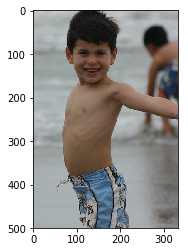

Greedy: young boy in red shorts plays in the water


In [86]:
z=1
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

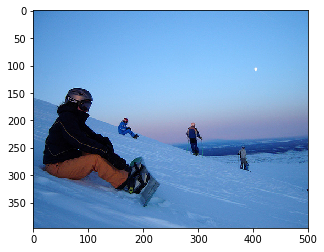

Greedy: man in red jacket is standing on top of mountain


In [87]:
z=10
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

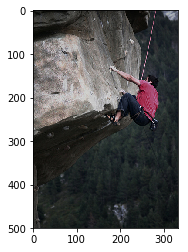

Greedy: man is rock climbing without rope


In [88]:
z=999
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

In [89]:
len(encoding_test)

1000

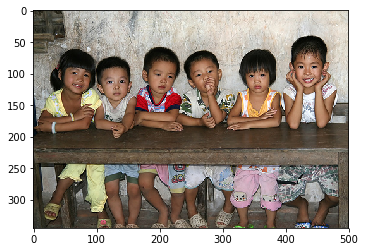

Greedy: two girls are sitting on bed in front of some trees


In [90]:
z=998
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

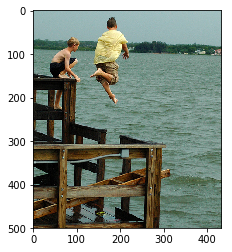

Greedy: man and woman are walking along the water near the water


In [91]:
z=997
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

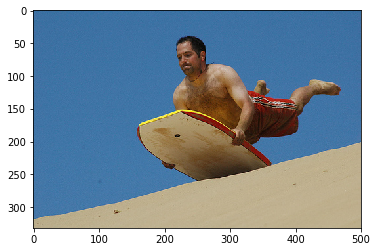

Greedy: man in red shirt is standing on the beach


In [92]:
z=996
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

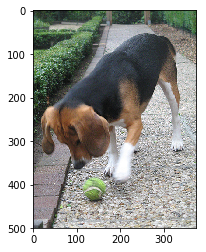

Greedy: dog is running through the grass


In [93]:
z=995
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

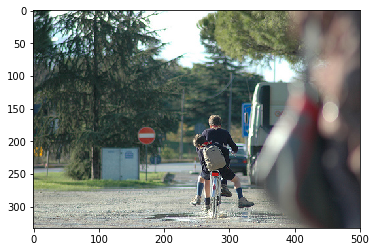

Greedy: man in jeans and cap is riding unicycle down the street


In [94]:
z=500
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

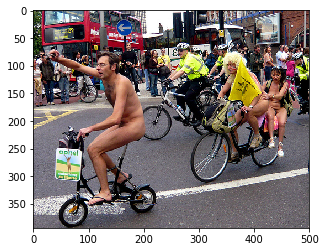

Greedy: man in red shirt and jeans is riding unicycle on street


In [95]:
z=300
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

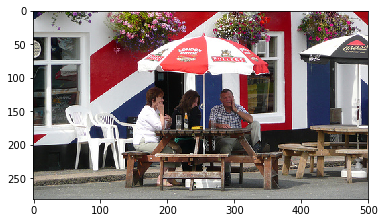

Greedy: man in black shirt is standing outside


In [96]:
z=20
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

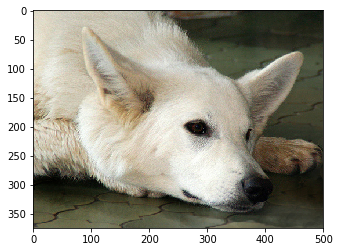

Greedy: shaggy dog is running through the snow


In [97]:
z=3
pic = list(encoding_test.keys())[z]
image = encoding_test[pic].reshape((1,2048))
x=plt.imread(images+"//"+pic)
plt.imshow(x)
plt.show()
print("Greedy:",greedySearch(image))

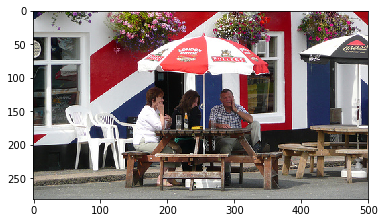

Greedy: man in black shirt is standing outside


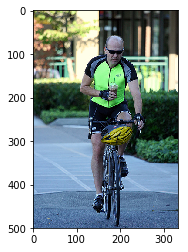

Greedy: man in red shirt is riding bicycle on street


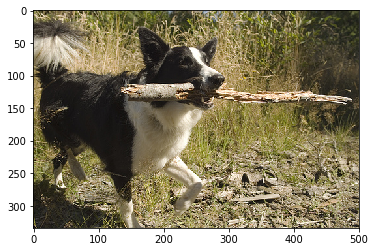

Greedy: black and white dog is followed carrying stick in his mouth


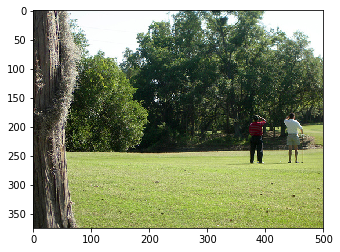

Greedy: the man is standing on top of the grass and holding fishing pole


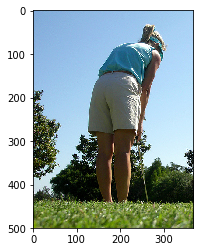

Greedy: young girl in pink dress is walking along gravel path


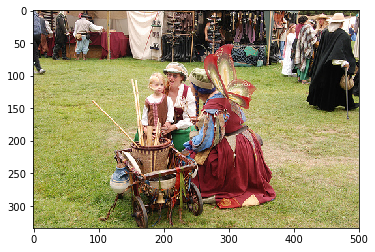

Greedy: group of people are sitting around fire pit


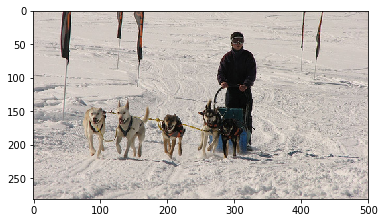

Greedy: dog sled team in the snow


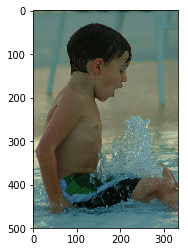

Greedy: boy in swimming pool


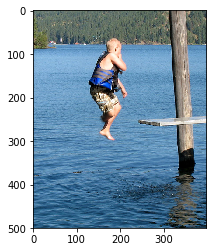

Greedy: woman in red bikini is standing on the beach near the water


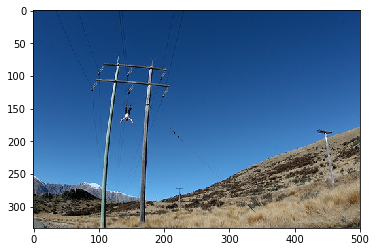

Greedy: man is standing on top of mountain


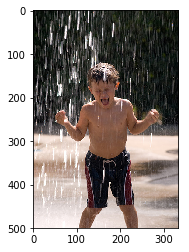

Greedy: little boy is running through the water


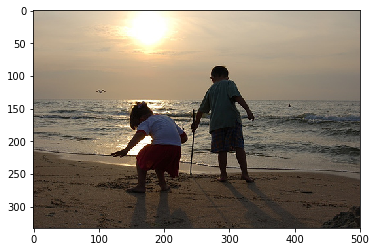

Greedy: man and woman are walking towards the beach


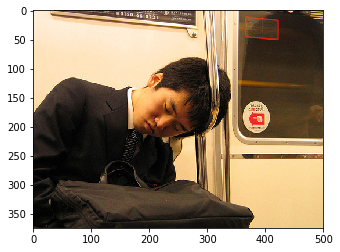

Greedy: man in black shirt is sitting on the carpet


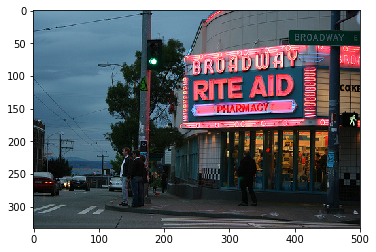

Greedy: man in black shirt is standing in front of sign


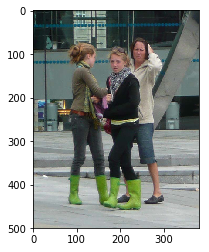

Greedy: woman walking down sidewalk


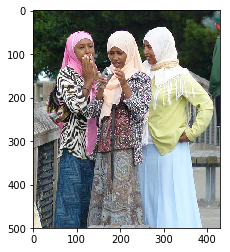

Greedy: woman in white dress and tank top is smiling


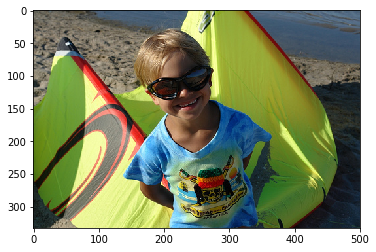

Greedy: young boy with red shirt is standing on the sidewalk


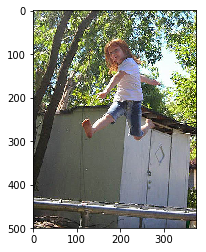

Greedy: boy in red shirt is jumping on the monkey beam


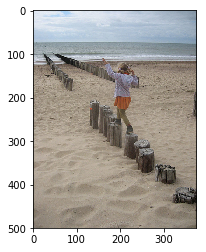

Greedy: two people are walking on rocks near the water


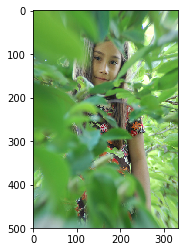

Greedy: two girls in colourful dresses are standing in front of some trees


In [98]:
for i in range(20,40):
    z=i
    pic = list(encoding_test.keys())[z]
    image = encoding_test[pic].reshape((1,2048))
    x=plt.imread(images+"//"+pic)
    plt.imshow(x)
    plt.show()
    print("Greedy:",greedySearch(image))

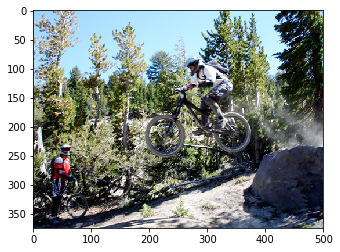

Greedy: man in blue shirt is riding bike on rocky trail


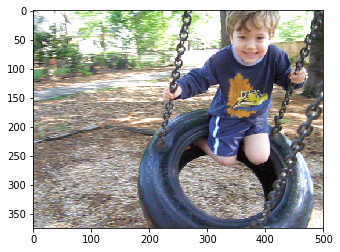

Greedy: young boy is jumping on the swing


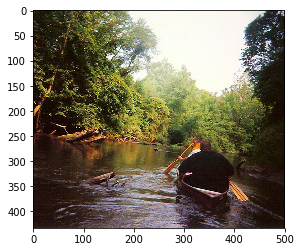

Greedy: two people are sitting on the dock of lake


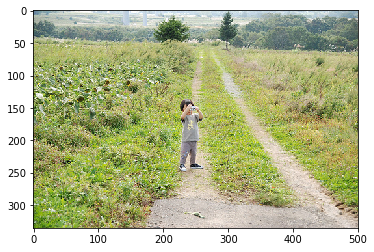

Greedy: two girls are sitting on grassy plain


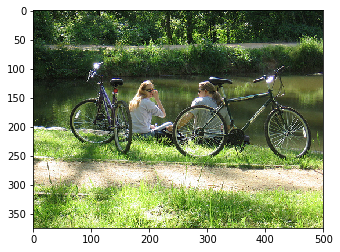

Greedy: man rides bicycle down dirt hill


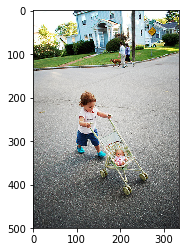

Greedy: small child is playing with toy


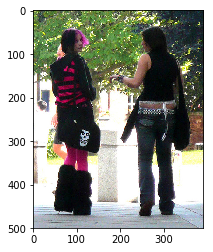

Greedy: woman in red shirt walks down the street


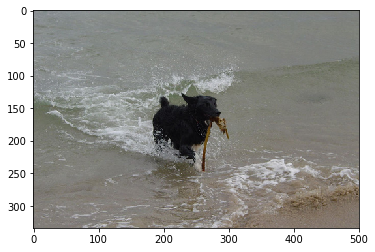

Greedy: two dogs are playing in the water


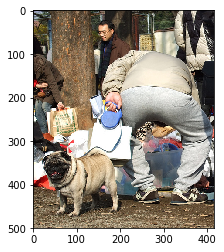

Greedy: two children are sitting on bed and play with red


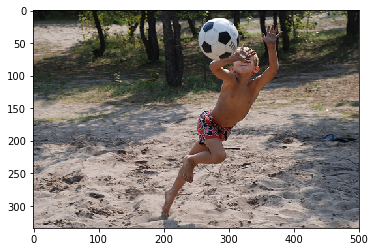

Greedy: two boys are playing soccer on the beach


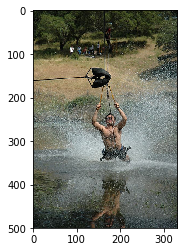

Greedy: man is standing on surfboard paddling


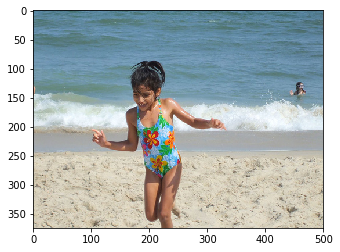

Greedy: young boy in swim trunks is walking on the beach


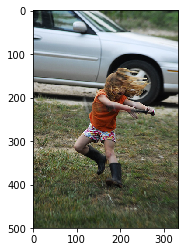

Greedy: little boy in blue shirt and jeans is running on the grass


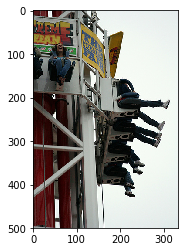

Greedy: man in red shirt is standing in front of red building


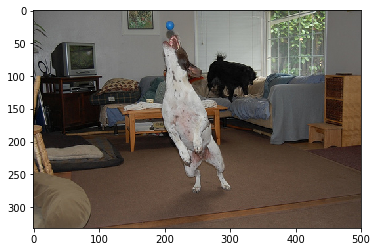

Greedy: two dogs are playing with bubble


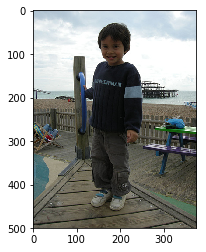

Greedy: woman in red shirt and backpack walks down the street


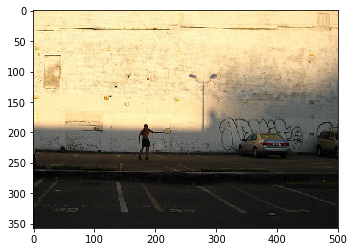

Greedy: man in red jacket is standing on the sidewalk


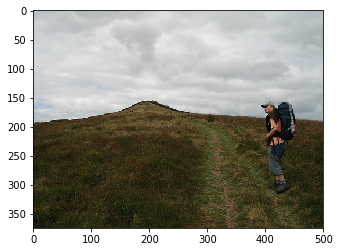

Greedy: two children are walking on path together


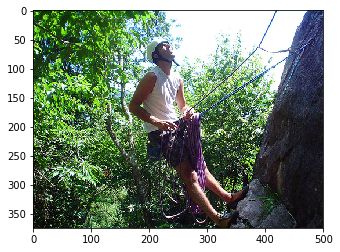

Greedy: the man is standing on rock next to tree


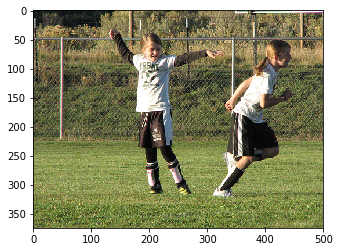

Greedy: two children are playing soccer on grassy field


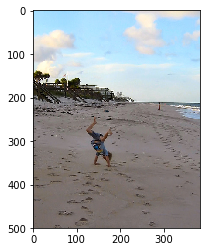

Greedy: three girls do on the beach


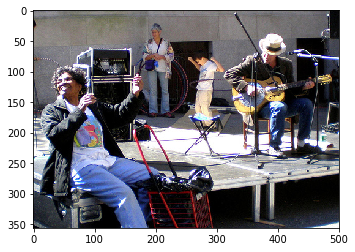

Greedy: two men are sitting on the carpet


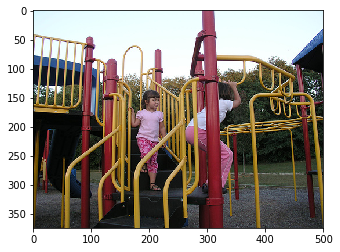

Greedy: little girl in pink dress is walking along the street


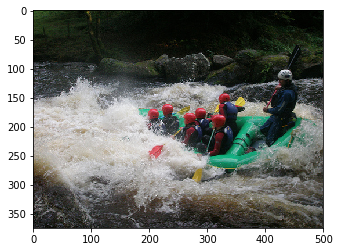

Greedy: group of people are rafting through river


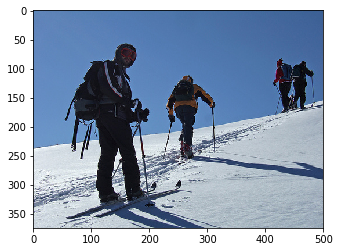

Greedy: woman wearing red coat skiing down snowy hill


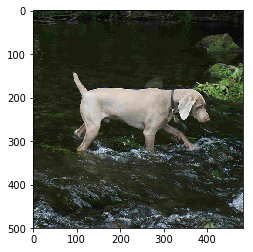

Greedy: dog is running through the water


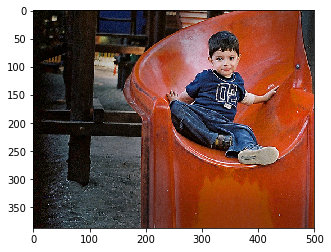

Greedy: young boy in red shirt is standing on the sidewalk near wooden parking


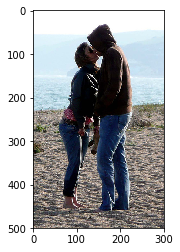

Greedy: the woman is walking along the rocks edge


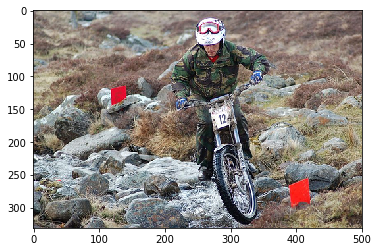

Greedy: man in blue shirt is riding bike on path


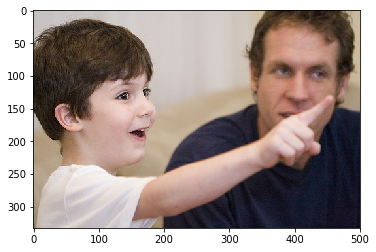

Greedy: woman with red hair is smiling


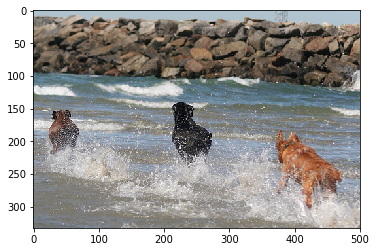

Greedy: two dogs are playing in the surf


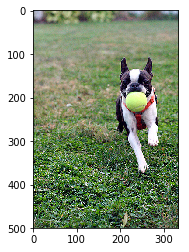

Greedy: two dogs are playing with red ball


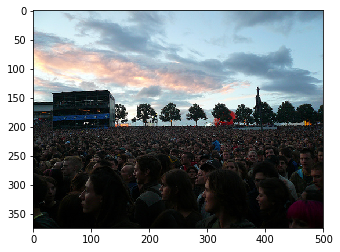

Greedy: group of people are standing in line on the ground


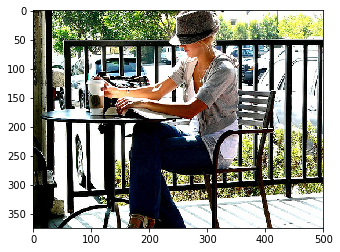

Greedy: man in black shirt is standing outside


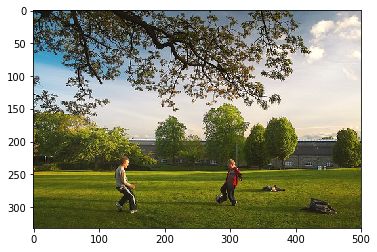

Greedy: two boys are playing soccer on the grass


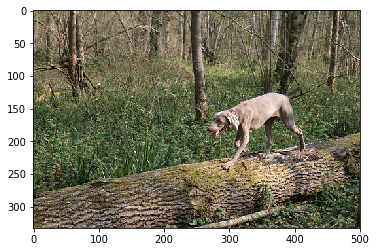

Greedy: brown dog is running through grassy area


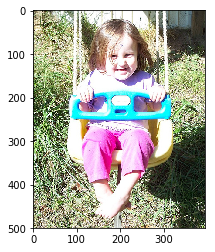

Greedy: young boy is swinging on the swing


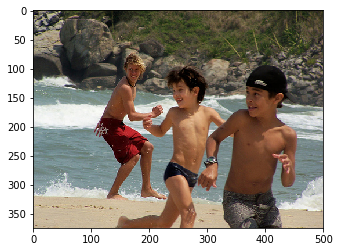

Greedy: young boy in red swim trunks walks on the beach


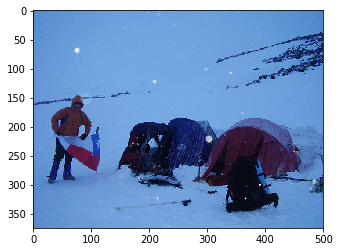

Greedy: tent in the snow


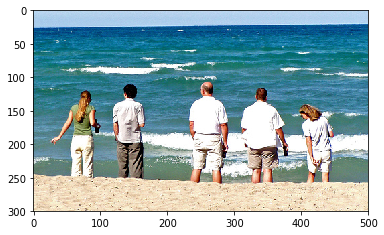

Greedy: three girls are sitting on the shore of the ocean


In [99]:
for i in range(40,80):
    z=i
    pic = list(encoding_test.keys())[z]
    image = encoding_test[pic].reshape((1,2048))
    x=plt.imread(images+"//"+pic)
    plt.imshow(x)
    plt.show()
    print("Greedy:",greedySearch(image))

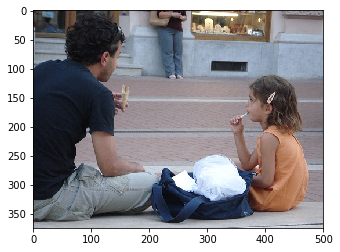

Greedy: two girls are sitting on wooden bench


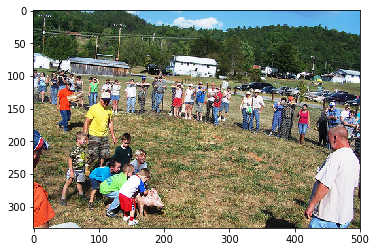

Greedy: group of people are standing on the ground near grassy field


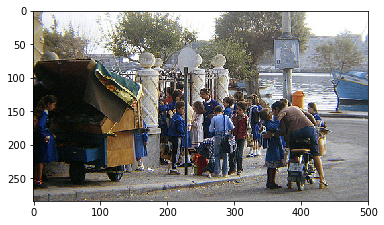

Greedy: man in black shirt and hat is walking past tables


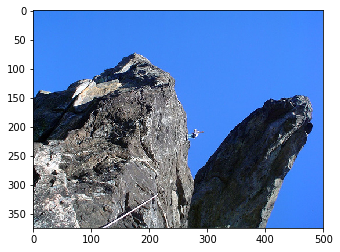

Greedy: man is standing on rock overlooking valley


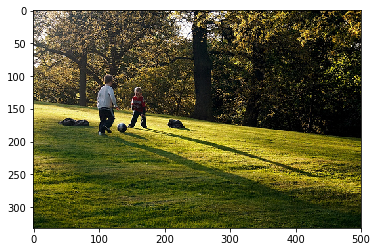

Greedy: young boy runs through the grass chased


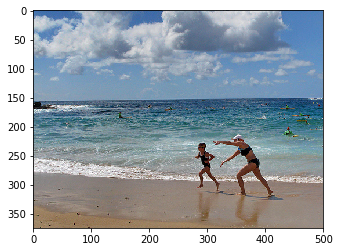

Greedy: man in swim trunks is walking on the beach carrying white surfboard


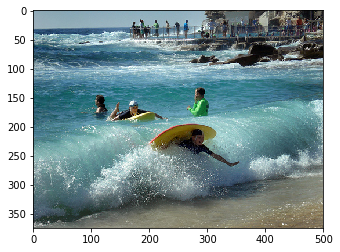

Greedy: child is surfing in the ocean


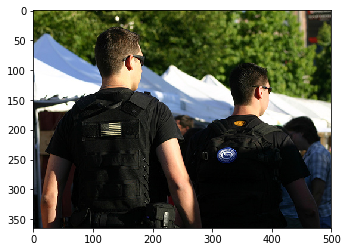

Greedy: man with red mohawk is smiling


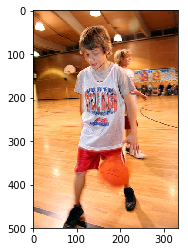

Greedy: little boy in blue shirt and jeans is running on the grass


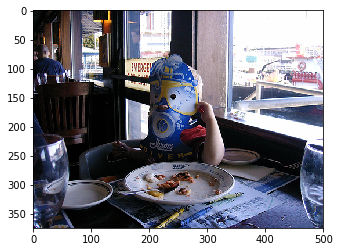

Greedy: young boy with red shirt and blue eyes is eating


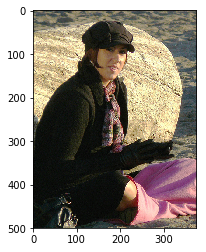

Greedy: man in red shirt is standing on rock overlooking valley


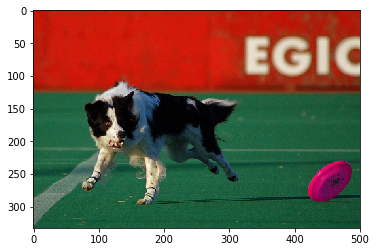

Greedy: two dogs are playing together on the grass


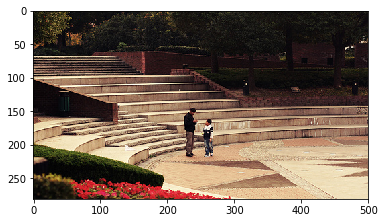

Greedy: woman in dress walks down bridge


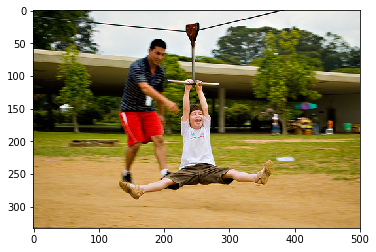

Greedy: two children are playing soccer on grassy field


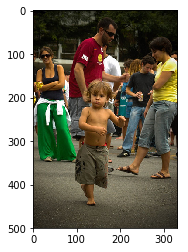

Greedy: two girls are sitting on walkway


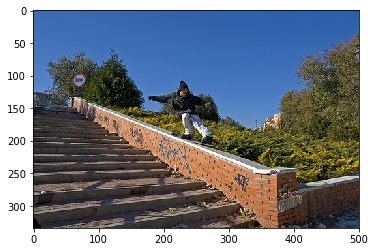

Greedy: man sits on bleachers near the water


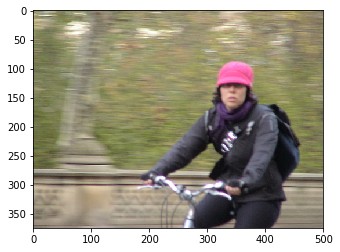

Greedy: man in camouflage jacket is standing on top of mountain


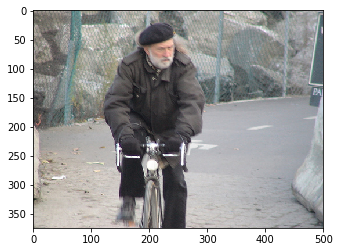

Greedy: man in cap is standing on top of mountain


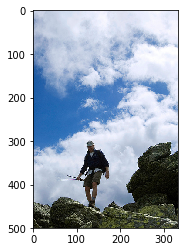

Greedy: man is standing on top of cliff overlooking rough water


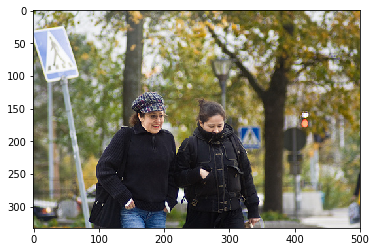

Greedy: man in black jacket and cap is standing next to woman in black jacket


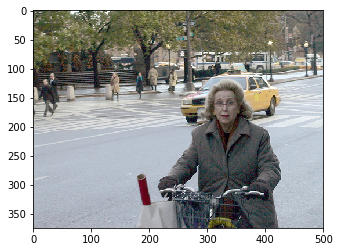

Greedy: man in jeans and hat is riding unicycle down the sidewalk


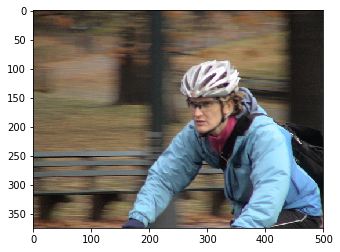

Greedy: man in blue shirt is standing on the sidewalk near the street


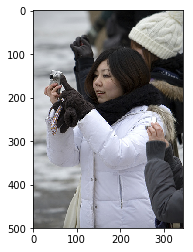

Greedy: woman in red jacket is standing next to woman in red jacket


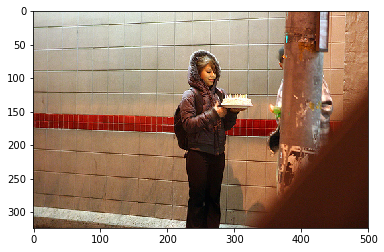

Greedy: man in black shirt is standing on the cement deck of an empty wood bench


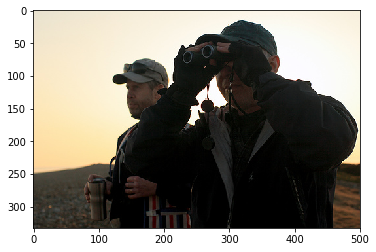

Greedy: man in white shirt and cap smokes cigarette


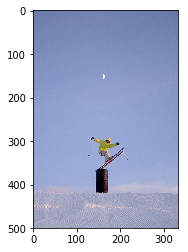

Greedy: man is standing on top of rocky cliff


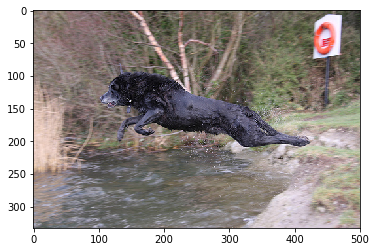

Greedy: black dog is running through the water


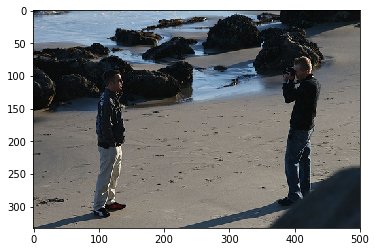

Greedy: woman in red bikini is standing on the beach


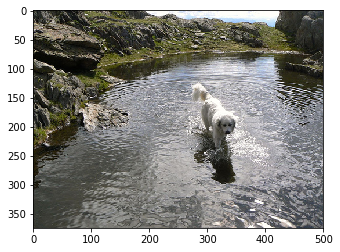

Greedy: dog swimming through water


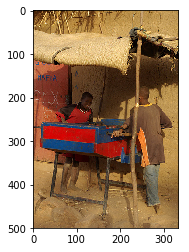

Greedy: two girls are sitting on wooden platform


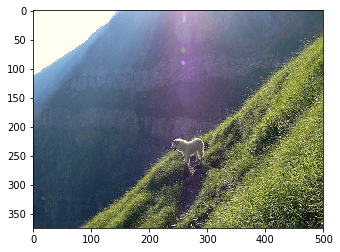

Greedy: person is walking on narrow path


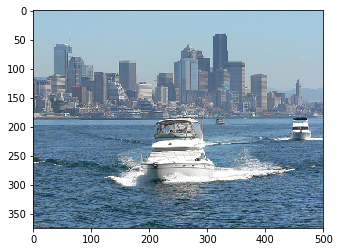

Greedy: man in red swimming trunks is standing on the shore of boat


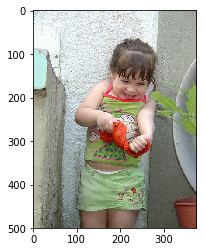

Greedy: little girl in pink shirt is laying on her back in the grass


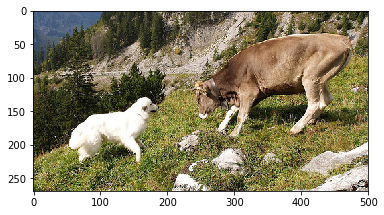

Greedy: two dogs are playing in the grass


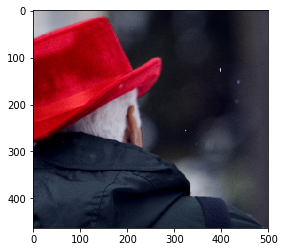

Greedy: man with long hair and beard is sitting on bench


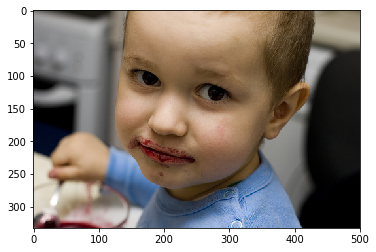

Greedy: young boy licks his nose


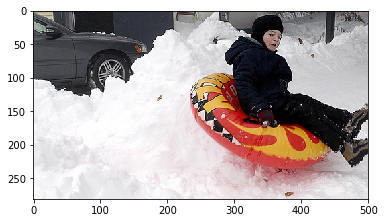

Greedy: child in red coat is shoveling down snowy hill


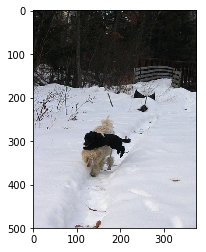

Greedy: dog runs through the snow


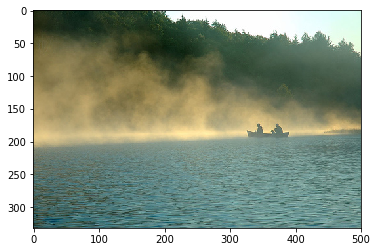

Greedy: ship is pulled boat in the water


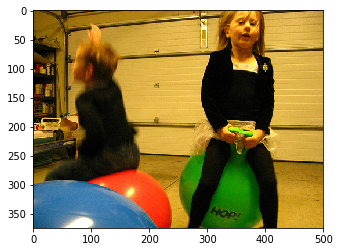

Greedy: two girls are sitting on wooden floor


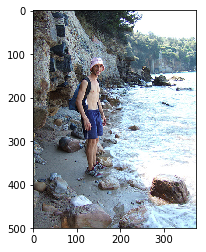

Greedy: two girls are jumping into water


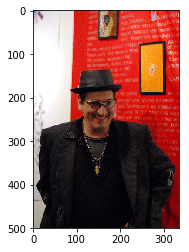

Greedy: man in black shirt is standing in front of white building


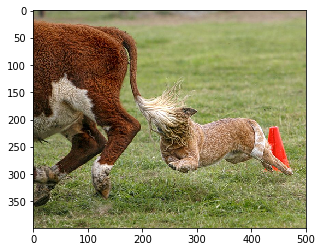

Greedy: two dogs are wrestling in the grass


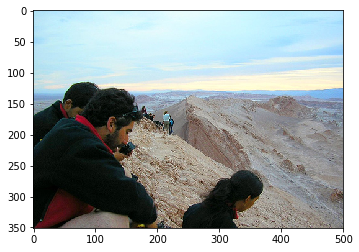

Greedy: man in red shirt is standing on rock overlooking valley


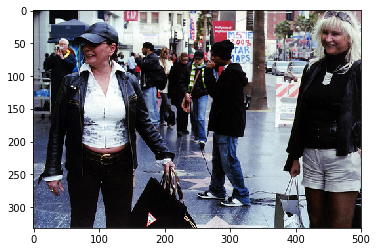

Greedy: man in black shirt and tie is standing in front of restaurant


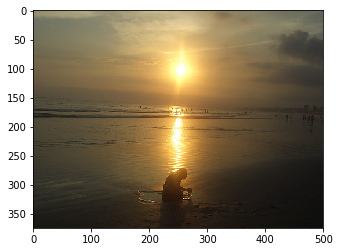

Greedy: man is standing on the shore of the ocean


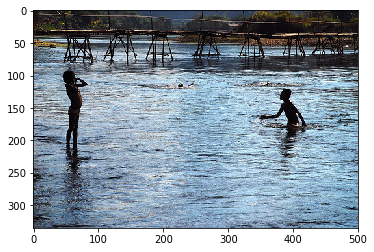

Greedy: two people are standing on the edge of the water


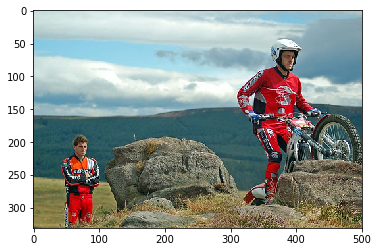

Greedy: man in red shirt is riding bike on rocky trail


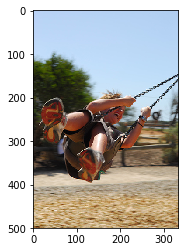

Greedy: young girl is jumping on rope bridge


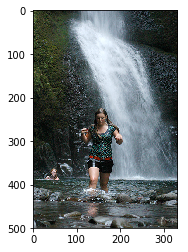

Greedy: man in red shorts is standing in the water


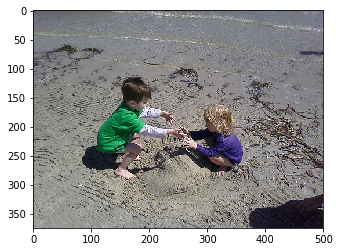

Greedy: two girls are walking along rocks path


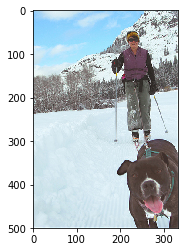

Greedy: dog is running through the snow


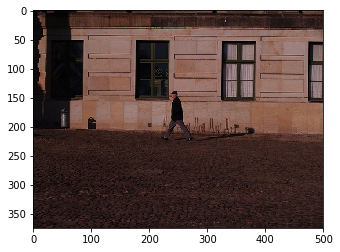

Greedy: man in red shirt is standing on the sidewalk near building


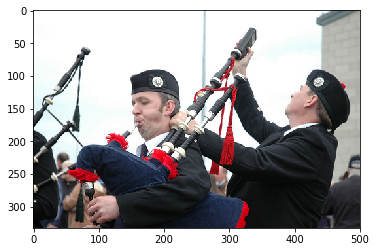

Greedy: man in white shirt and tie is holding up silver


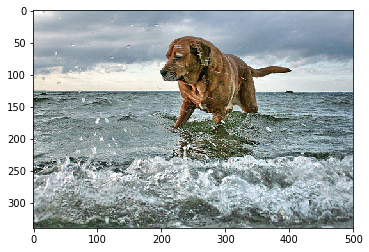

Greedy: brown dog is running through the water


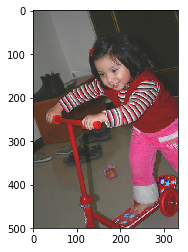

Greedy: little boy is riding toy scooter on the street


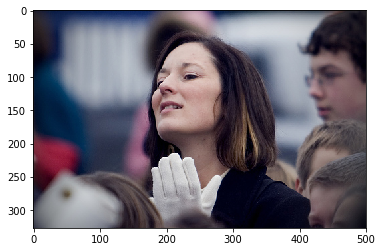

Greedy: woman with red hair is smiling


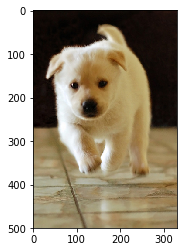

Greedy: dog is running through the grass


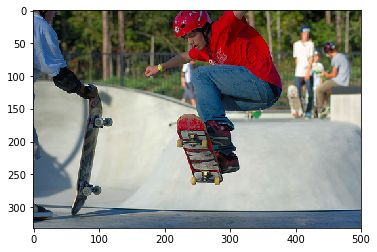

Greedy: man in camouflage vest is standing on the edge of rock


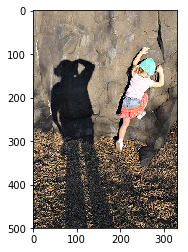

Greedy: two girls are sitting on the ground next to pond


In [100]:
for i in range(100,160):
    z=i
    pic = list(encoding_test.keys())[z]
    image = encoding_test[pic].reshape((1,2048))
    x=plt.imread(images+"//"+pic)
    plt.imshow(x)
    plt.show()
    print("Greedy:",greedySearch(image))